## Loading the dataset

### List all the categories available

In [ ]:
### read the json file
import json
cats = json.load(open('/net/acadia10a/data/sparsh/mapillary/mapillary-2.0/config_v2.0.json', 'r'))
cats = {i['name']: i['color'] for i in cats['labels']}
cats

In [ ]:
cats = json.load(open('/net/acadia10a/data/sparsh/mapillary/mapillary-2.0/config_v2.0.json', 'r'))
cats

In [ ]:
import json
from PIL import Image
cats = json.load(open('/net/acadia7a/data/samuel/bdd100k/det_val.json', 'r'))
categories = {}
valid_cats = ['car', 'motorcycle', 'bus', 'truck', 'bicycle']
for i in cats:
    cat_image = i['labels']
    image_path = '/net/acadia7a/data/samuel/bdd100k/images/100k/val/%s'%i['name']
    for j in cat_image:
        if j['category'] in valid_cats:
            if 'box2d' in j:
                print(j['category'])
                x1, y1, x2, y2 = int(j['box2d']['x1']), int(j['box2d']['y1']), int(j['box2d']['x2']), int(j['box2d']['y2'])
                print(x1, y1, x2, y2)
                image = cv2.imread(image_path)
                image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
                cropped_image = image[y1:y2, x1:x2] 
                display(Image.fromarray(cropped_image))
                cv2.rectangle(image, (x1, y1), (x2, y2), (255, 0, 0), 5)

In [ ]:
cats = json.load(open('/net/acadia7a/data/samuel/bdd100k/det_val.json', 'r'))
categories = set()
for i in cats:
    for j in i['labels']:
        categories.add(j['category'])
categories

### Fetch vehicles and visualize the objects

In [ ]:
### read the polygon file
import cv2
import numpy as np
from PIL import Image
vehicles_categories = {
  "Bicycle": [119, 11, 32],
  "Boat": [150, 0, 255],
  "Bus": [0, 60, 100],
  "Car": [0, 0, 142],
  "Caravan": [0, 0, 90],
  "Motorcycle": [0, 0, 230],
  "On Rails": [0, 80, 100],
  "Other Vehicle": [128, 64, 64],
  "Trailer": [0, 0, 110],
  "Truck": [0, 0, 70],
  "Vehicle Group": [0, 0, 142],
  "Wheeled Slow": [0, 0, 192],
  "Car Mount": [32, 32, 32]
}
def read_polygon(polygon_path):
    polys = json.load(open(polygon_path, 'r'))
    vehicle_instances = {}
    for i in polys['objects']:
        if 'vehicle' in i['label']:
            if i['label'] not in vehicle_instances:
                vehicle_instances[i['label']] = [i['polygon']]
            else:
                vehicle_instances[i['label']].append(i['polygon'])
    return vehicle_instances

def visualization(image_path, all_polygon_points):
    image = cv2.imread(image_path)

    # Draw polygon
    for key, polygon_points in all_polygon_points.items():
        for poly in polygon_points:
            poly = np.array(poly).astype(np.int32)
            cv2.polylines(image, [poly], isClosed=True, color=(0, 255, 0), thickness=5)
            x, y, w, h = cv2.boundingRect(poly)
            cv2.rectangle(image, (x, y), (x + w, y + h), (255, 0, 0), 2)

            font = cv2.FONT_HERSHEY_SIMPLEX
            cv2.putText(image, key, (x, y - 10), font, 1, (255, 0, 0), 2, cv2.LINE_AA)
    return Image.fromarray(image)


### Load InternVL to relabel the vehicles into following categories: 
Car

Bus

Truck

Bicycle

Motorcycle

Boat

Trailer

Caravan

On Rails

Other Vehicle

Vehicle Group

Wheeled Slow

In [ ]:
from PIL import Image, ImageDraw
from torchvision.transforms.functional import InterpolationMode
from transformers import AutoModel, AutoTokenizer
import numpy as np
import torch
import torchvision.transforms as T

def build_transform(input_size):
    MEAN, STD = IMAGENET_MEAN, IMAGENET_STD
    transform = T.Compose([
        T.Lambda(lambda img: img.convert('RGB') if img.mode != 'RGB' else img),
        T.Resize((input_size, input_size), interpolation=InterpolationMode.BICUBIC),
        T.ToTensor(),
        T.Normalize(mean=MEAN, std=STD)
    ])
    return transform

def find_closest_aspect_ratio(aspect_ratio, target_ratios, width, height, image_size):
    best_ratio_diff = float('inf')
    best_ratio = (1, 1)
    area = width * height
    for ratio in target_ratios:
        target_aspect_ratio = ratio[0] / ratio[1]
        ratio_diff = abs(aspect_ratio - target_aspect_ratio)
        if ratio_diff < best_ratio_diff:
            best_ratio_diff = ratio_diff
            best_ratio = ratio
        elif ratio_diff == best_ratio_diff:
            if area > 0.5 * image_size * image_size * ratio[0] * ratio[1]:
                best_ratio = ratio
    return best_ratio

def dynamic_preprocess(image, min_num=1, max_num=12, image_size=448, use_thumbnail=False):
    orig_width, orig_height = image.size
    aspect_ratio = orig_width / orig_height

    # calculate the existing image aspect ratio
    target_ratios = set(
        (i, j) for n in range(min_num, max_num + 1) for i in range(1, n + 1) for j in range(1, n + 1) if
        i * j <= max_num and i * j >= min_num)
    target_ratios = sorted(target_ratios, key=lambda x: x[0] * x[1])

    # find the closest aspect ratio to the target
    target_aspect_ratio = find_closest_aspect_ratio(
        aspect_ratio, target_ratios, orig_width, orig_height, image_size)

    # calculate the target width and height
    target_width = image_size * target_aspect_ratio[0]
    target_height = image_size * target_aspect_ratio[1]
    blocks = target_aspect_ratio[0] * target_aspect_ratio[1]

    # resize the image
    resized_img = image.resize((target_width, target_height))
    processed_images = []
    for i in range(blocks):
        box = (
            (i % (target_width // image_size)) * image_size,
            (i // (target_width // image_size)) * image_size,
            ((i % (target_width // image_size)) + 1) * image_size,
            ((i // (target_width // image_size)) + 1) * image_size
        )
        # split the image
        split_img = resized_img.crop(box)
        processed_images.append(split_img)
    assert len(processed_images) == blocks
    if use_thumbnail and len(processed_images) != 1:
        thumbnail_img = image.resize((image_size, image_size))
        processed_images.append(thumbnail_img)
    return processed_images

def load_image(image, input_size=448, max_num=12):
    #image = Image.open(image_file).convert('RGB')
    transform = build_transform(input_size=input_size)
    images = dynamic_preprocess(image, image_size=input_size, use_thumbnail=True, max_num=max_num)
    pixel_values = [transform(image) for image in images]
    pixel_values = torch.stack(pixel_values)
    return pixel_values


path = 'OpenGVLab/InternVL2_5-8B-MPO'
model = AutoModel.from_pretrained(
    path,
    torch_dtype=torch.bfloat16,
    low_cpu_mem_usage=True,
    use_flash_attn=True,
    trust_remote_code=True).eval().cuda()
tokenizer1 = AutoTokenizer.from_pretrained(path, trust_remote_code=True, use_fast=False)

prompt1 = """<image>\nYou are an expert in autonomous driving, specializing in analyzing traffic scenes.                
            Your task is to look at the obstacle in the red bbox inside green polygon  and output the response in the format below. think step by step before deciding the answer
            Strictly follow the rules.
            {
                "category": "[Choose ONE category among the following for the most dominant object in the bounding box: "car", "bus", "truck", "bicycle", "motorbicycle", "boat", "trailer", "train"]"		                     
            }"""

generation_config = dict(max_new_tokens=1024, do_sample=True)

all_polygon_points = read_polygon('/net/acadia10a/data/sparsh/mapillary/mapillary-2.0/validation/v2.0/polygons/mURdvO8w-pV8dqsqLntWCQ.json')
image_path = '/net/acadia10a/data/sparsh/mapillary/mapillary-2.0/validation/images/mURdvO8w-pV8dqsqLntWCQ.jpg'
image = cv2.imread(image_path)
for key, polygon_points in all_polygon_points.items():
    for poly in polygon_points:
        poly = np.array(poly).astype(np.int32)
        cv2.polylines(image, [poly], isClosed=True, color=(0, 255, 0), thickness=5)
        x, y, w, h = cv2.boundingRect(poly)
        cv2.rectangle(image, (x, y), (x + w, y + h), (255, 0, 0), 2)
        cropped_image = image[y:y + h, x:x + w] 
        #display(Image.fromarray(cropped_image))
        pixel_values = load_image(Image.fromarray(cropped_image), max_num=12).to(torch.bfloat16).cuda()
        response11 = model.chat(tokenizer1, pixel_values, prompt1, generation_config)
        print("Ground Truth:", key)
        print("Prediction:", response11)

In [ ]:
from transformers import AutoModelForCausalLM, AutoTokenizer

model_name = "Qwen/Qwen2.5-7B-Instruct"

model = AutoModelForCausalLM.from_pretrained(
    model_name,
    torch_dtype="auto",
    device_map="auto"
)
tokenizer = AutoTokenizer.from_pretrained(model_name)

prompt = "Give me a short introduction to large language model."
messages = [
    {"role": "system", "content": "You are Qwen, created by Alibaba Cloud. You are a helpful assistant."},
    {"role": "user", "content": prompt}
]
text = tokenizer.apply_chat_template(
    messages,
    tokenize=False,
    add_generation_prompt=True
)
model_inputs = tokenizer([text], return_tensors="pt").to(model.device)

generated_ids = model.generate(
    **model_inputs,
    max_new_tokens=512
)
generated_ids = [
    output_ids[len(input_ids):] for input_ids, output_ids in zip(model_inputs.input_ids, generated_ids)
]

response = tokenizer.batch_decode(generated_ids, skip_special_tokens=True)[0]


In [ ]:
from transformers import Qwen2_5_VLForConditionalGeneration, AutoTokenizer, AutoProcessor
from qwen_vl_utils import process_vision_info

# default: Load the model on the available device(s)
model = Qwen2_5_VLForConditionalGeneration.from_pretrained(
    "Qwen/Qwen2.5-VL-7B-Instruct", torch_dtype="auto", device_map="auto"
)

# We recommend enabling flash_attention_2 for better acceleration and memory saving, especially in multi-image and video scenarios.
# model = Qwen2_5_VLForConditionalGeneration.from_pretrained(
#     "Qwen/Qwen2.5-VL-7B-Instruct",
#     torch_dtype=torch.bfloat16,
#     attn_implementation="flash_attention_2",
#     device_map="auto",
# )

# default processer
processor = AutoProcessor.from_pretrained("Qwen/Qwen2.5-VL-7B-Instruct")

# The default range for the number of visual tokens per image in the model is 4-16384.
# You can set min_pixels and max_pixels according to your needs, such as a token range of 256-1280, to balance performance and cost.
# min_pixels = 256*28*28
# max_pixels = 1280*28*28
# processor = AutoProcessor.from_pretrained("Qwen/Qwen2.5-VL-7B-Instruct", min_pixels=min_pixels, max_pixels=max_pixels)

messages = [
    {
        "role": "user",
        "content": [
            {
                "type": "image",
                "image": "https://qianwen-res.oss-cn-beijing.aliyuncs.com/Qwen-VL/assets/demo.jpeg",
            },
            {"type": "text", "text": "Describe this image."},
        ],
    }
]

# Preparation for inference
text = processor.apply_chat_template(
    messages, tokenize=False, add_generation_prompt=True
)
image_inputs, video_inputs = process_vision_info(messages)
inputs = processor(
    text=[text],
    images=image_inputs,
    videos=video_inputs,
    padding=True,
    return_tensors="pt",
)
inputs = inputs.to("cuda")

# Inference: Generation of the output
generated_ids = model.generate(**inputs, max_new_tokens=128)
generated_ids_trimmed = [
    out_ids[len(in_ids) :] for in_ids, out_ids in zip(inputs.input_ids, generated_ids)
]
output_text = processor.batch_decode(
    generated_ids_trimmed, skip_special_tokens=True, clean_up_tokenization_spaces=False
)
print(output_text)


In [ ]:
import json
data = json.load(open('/net/acadia12a/data/samuel/objects365v1/zsy_objv1_train_xdino.json', 'r'))

In [ ]:
data.keys()

In [ ]:
data['categories']

In [ ]:
data['images'][0]

In [ ]:
import os
import json
import cv2

def save_cropped_images(annotations_path, images_dir, output_dir, target_labels):
    """
    Extracts and saves cropped images based on given labels from COCO-format Object365 data.

    Args:
        annotations_path (str): Path to the COCO JSON annotation file.
        images_dir (str): Directory containing original images.
        output_dir (str): Directory where cropped images will be saved.
        target_labels (list): List of labels to extract and save.

    Returns:
        None
    """
    # Load COCO JSON annotations
    with open(annotations_path, "r") as f:
        coco_data = json.load(f)

    # Create a mapping from category ID to category name
    category_mapping = {cat["id"]: cat["name"] for cat in coco_data["categories"]}

    # Reverse mapping (label -> category_id)
    label_to_category_id = {v: k for k, v in category_mapping.items()}

    # Filter annotations based on target labels
    target_category_ids = {label_to_category_id[label] for label in target_labels if label in label_to_category_id}

    # Create a mapping from image ID to file name
    image_id_to_filename = {img["id"]: img["file_name"] for img in coco_data["images"]}

    # Create output directories for each label
    for label in target_labels:
        os.makedirs(os.path.join(output_dir, label), exist_ok=True)

    # Iterate over annotations and crop images
    for ann in coco_data["annotations"]:
        category_id = ann["category_id"]
        if category_id in target_category_ids:
            image_id = ann["image_id"]
            bbox = ann["bbox"]  # Format: [x, y, width, height]

            # Load the corresponding image
            image_filename = image_id_to_filename.get(image_id)
            if not image_filename:
                continue

            image_path = os.path.join(images_dir, image_filename)
            if not os.path.exists(image_path):
                print(f"Warning: Image {image_path} not found.")
                continue

            image = cv2.imread(image_path)
            if image is None:
                print(f"Warning: Failed to load image {image_path}.")
                continue

            # Crop the object
            x, y, w, h = map(int, bbox)
            cropped_image = image[y:y+h, x:x+w]

            # Skip empty crops
            if cropped_image.size == 0:
                continue

            # Save the cropped image in the corresponding label folder
            label_name = category_mapping[category_id]
            save_path = os.path.join(output_dir, label_name, f"{image_id}_{ann['id']}.jpg")
            cv2.imwrite(save_path, cropped_image)

            print(f"Saved: {save_path}")

    print("Cropping and saving completed!")

annotations_path = '/net/acadia12a/data/samuel/objects365v1/zsy_objv1_train_xdino.json'
images_dir = '/net/acadia12a/data/samuel/objects365v1/train'
output_dir = '/net/acadia14a/data/sparsh/Relabeling/dinov2_data/new_vehicles'
target_labels = [
    'car', 'suv', 'van', 'bus', 'motorcycle', 'bicycle', 'pickup truck', 'truck',
    'machinery vehicle', 'sports car', 'fire truck', 'heavy truck', 'ambulance',
    'tricycle', 'rickshaw', 'trolley', 'carriage', 'formula 1 car', 'hoverboard',
    'wheelchair', 'scooter', 'airplane', 'helicopter', 'hot air ballon',
    'boat', 'sailboat', 'ship'
]
save_cropped_images(annotations_path, images_dir, output_dir, target_labels)

In [1]:
import json
data = json.load(open('instances_default.json', 'r'))


In [7]:
data['images'][-1]

{'id': 2000,
 'width': 3264,
 'height': 2448,
 'file_name': 'zyupbI4cbeYqIPXQOANOeQ.jpg',
 'license': 0,
 'flickr_url': '',
 'coco_url': '',
 'date_captured': 0}

In [4]:
data['annotations'][0]

{'id': 1,
 'image_id': 1,
 'category_id': 7,
 'segmentation': [[126.24,
   685.0,
   119.79,
   798.08,
   74.21,
   792.49,
   82.38,
   680.27]],
 'area': 5073.0,
 'bbox': [74.21, 680.27, 52.03, 117.81],
 'iscrowd': 0,
 'attributes': {'Type of Signs': '- Others', 'occluded': False}}

In [5]:
data['categories']

[{'id': 1, 'name': 'Circular-Sign', 'supercategory': ''},
 {'id': 2, 'name': 'Square-Sign', 'supercategory': ''},
 {'id': 3, 'name': 'Triangular-Sign', 'supercategory': ''},
 {'id': 4, 'name': 'Inverted-Triangular-Sign', 'supercategory': ''},
 {'id': 5, 'name': 'Diamond-Sign', 'supercategory': ''},
 {'id': 6, 'name': 'Auxiliary-Sign', 'supercategory': ''},
 {'id': 7, 'name': 'Sign', 'supercategory': ''},
 {'id': 8, 'name': 'Hexagonal-Sign', 'supercategory': ''}]

Do not enter Circular-Sign


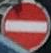

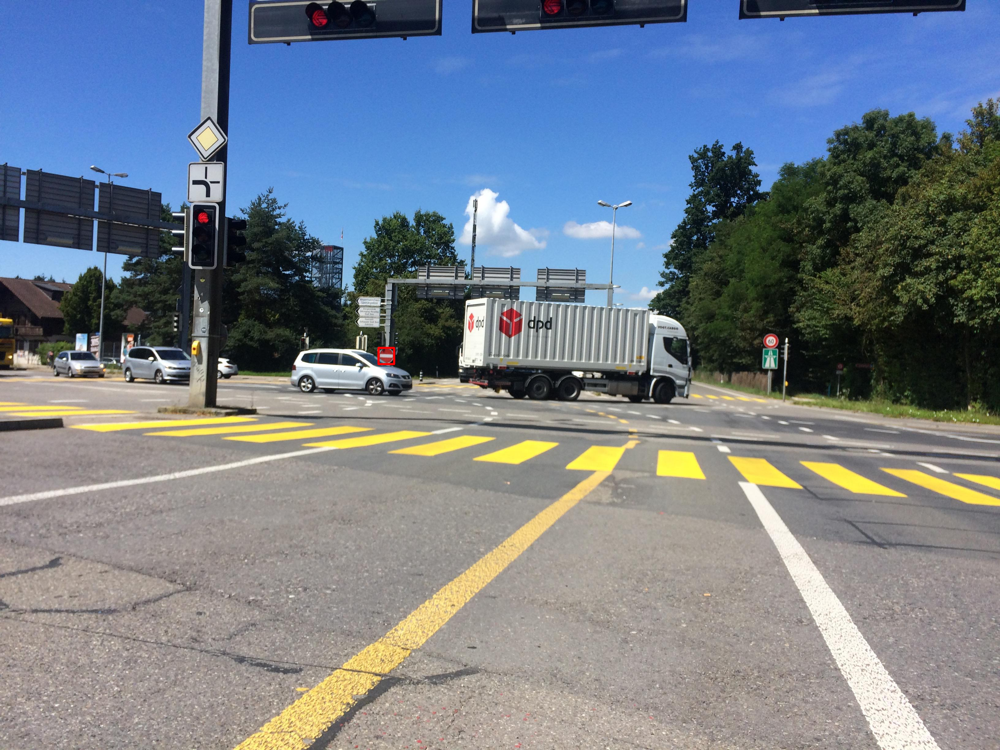

NameError: name 'build_transform' is not defined

In [ ]:
import numpy as np
import cv2
import math
from PIL import Image

vehicles_categories = {
  "Bicycle": [119, 11, 32],
  "Boat": [150, 0, 255],
  "Bus": [0, 60, 100],
  "Car": [0, 0, 142],
  "Caravan": [0, 0, 90],
  "Motorcycle": [0, 0, 230],
  "On Rails": [0, 80, 100],
  "Other Vehicle": [128, 64, 64],
  "Trailer": [0, 0, 110],
  "Truck": [0, 0, 70],
  "Vehicle Group": [0, 0, 142],
  "Wheeled Slow": [0, 0, 192],
  "Car Mount": [32, 32, 32]
}
def load_image(image, input_size=448, max_num=12):
    #image = Image.open(image_file).convert('RGB')
    transform = build_transform(input_size=input_size)
    images = dynamic_preprocess(image, image_size=input_size, use_thumbnail=True, max_num=max_num)
    pixel_values = [transform(image) for image in images]
    pixel_values = torch.stack(pixel_values)
    return pixel_values

data = json.load(open('instances_default.json', 'r'))
generation_config = dict(max_new_tokens=1024, do_sample=True)
correct_vlm1=0
correct_vlm2=0
total=0

for poly_file in data['annotations'][5:15]:
    filename = data['images'][poly_file['image_id']-1]['file_name']
    ground_truth = poly_file['attributes']['Type of Signs'].replace('- ', '')
    ground_shape = data['categories'][poly_file['category_id']-1]['name']
    if ground_truth=='Others' and ground_shape == 'Sign':
        continue
    image_path = '/net/acadia10a/data/sparsh/mapillary/mapillary-2.0/validation/images/%s'%filename
    print(ground_truth, ground_shape)
    #for key, polygon_points in all_polygon_points.items():
    image = cv2.imread(image_path)
    #cv2.polylines(image, [poly], isClosed=True, color=(0, 255, 0), thickness=5)
    x, y, w, h = poly_file['bbox']
    x = math.floor(x)
    y = math.floor(y)
    w = math.ceil(w)
    h = math.ceil(h)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    cropped_image = image[y:y + h, x:x + w] 
    display(Image.fromarray(cropped_image)) 
    #pixel_values = load_image(Image.fromarray(cropped_image), max_num=12).to(torch.bfloat16).cuda()
    cv2.rectangle(image, (x, y), (x + w, y + h), (255, 0, 0), 5)
    display(Image.fromarray(image)) 
    pixel_values_bigg = load_image(Image.fromarray(image), max_num=12).to(torch.bfloat16).cuda()
    response11 = model.chat(tokenizer1, pixel_values, prompt1, generation_config)
    response12 = model.chat(tokenizer1, pixel_values_bigg, prompt2, generation_config)
    gt=ground_truth
    response11 = response11.lower()
    response12 = response12.lower()
    if response11 == 'person':
        response11 = 'individual'
    if response12 == 'person':
        response12 = 'individual'

    print("Prediction1:", response11, " gt:", gt, "Prediction2:", response12)
    if gt == response11:
        correct_vlm1+=1
    if gt == response12:
        correct_vlm2+=1
    total+=1
print(correct_vlm1/total)
print(correct_vlm2/total)
                
            






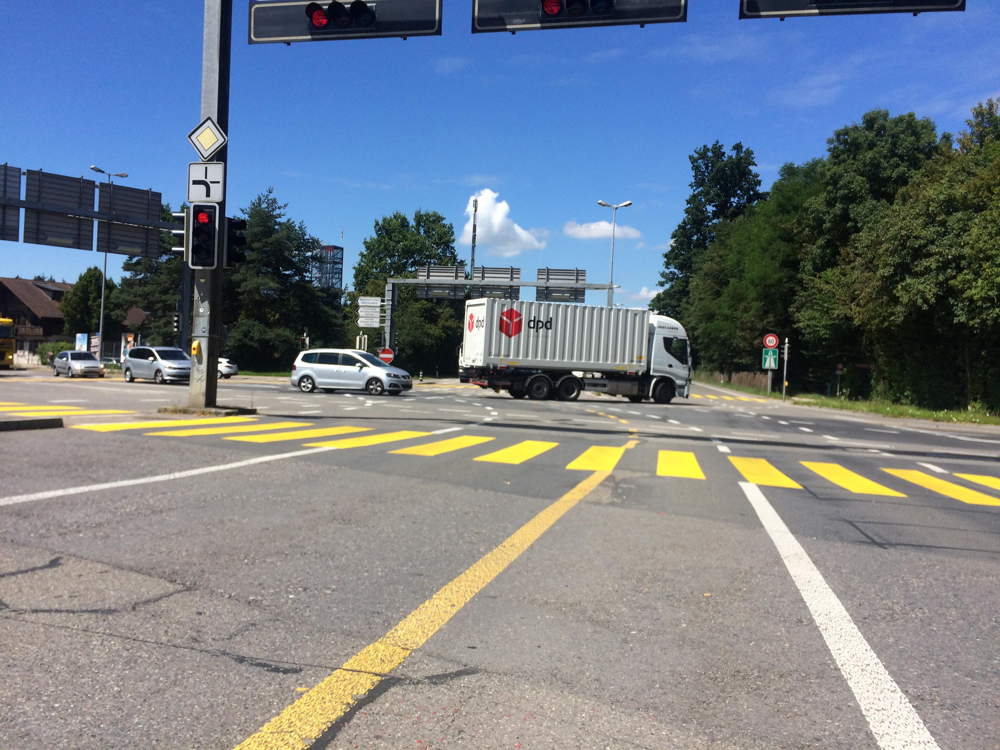

In [24]:
Image.open('/net/acadia10a/data/sparsh/mapillary/mapillary-2.0/validation/images/--BJs76vloEaiH-wppzWNA.jpg')